<a href="https://colab.research.google.com/github/ayushwattal/MaskRCNN/blob/main/MaskRCNN_Detectron2_03_08_22.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Roboflow and Detectron2 Pip Packages, Import Deps

In [ ]:
!python -m pip install roboflow
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 178 kB 7.1 MB/s 
     |████████████████████████████████| 67 kB 5.8 MB/s 
     |████████████████████████████████| 138 kB 50.1 MB/s 
     |████████████████████████████████| 54 kB 2.4 MB/s 
     |████████████████████████████████| 145 kB 58.9 MB/s 
     |████████████████████████████████| 4.3 MB 36.8 MB/s 
     |████████████████████████████████| 1.1 MB 55.4 MB/s 
     |████████████████████████████████| 21.6 MB 1.4 MB/s 
     |████████████████████████████████| 596 kB 57.2 MB/s 
     |████████████████████████████████| 62 kB 1.5 MB/s 
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9675 sha256=894a3d829284ba05cfaea361eca347f01374fbb4adfa836fd321358b2ba927ad
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built wget
  Attempting uninstall: urllib3
    Found existing ins

In [ ]:
import logging
import torch
from collections import OrderedDict
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.engine import DefaultTrainer
from detectron2.utils.visualizer import ColorMode
from detectron2.solver import build_lr_scheduler, build_optimizer
from detectron2.checkpoint import DetectionCheckpointer, PeriodicCheckpointer
from detectron2.utils.events import EventStorage
from detectron2.modeling import build_model
import detectron2.utils.comm as comm
from detectron2.engine import default_argument_parser, default_setup, default_writers, launch
from detectron2.data import (
    MetadataCatalog,
    build_detection_test_loader,
    build_detection_train_loader,
)
from detectron2.evaluation import (
    CityscapesInstanceEvaluator,
    CityscapesSemSegEvaluator,
    COCOEvaluator,
    COCOPanopticEvaluator,
    DatasetEvaluators,
    LVISEvaluator,
    PascalVOCDetectionEvaluator,
    SemSegEvaluator,
    inference_on_dataset,
    print_csv_format,
)

from roboflow import Roboflow

from matplotlib import pyplot as plt
from PIL import Image
from google.colab.patches import cv2_imshow
from detectron2.utils.visualizer import Visualizer

# Download dataset via Roboflow pip package and show a sample annotation

In [ ]:
VERSION = 17

In [ ]:
rf = Roboflow(api_key="gZ889YZoIUvo6Bvc6lsU")
project = rf.workspace("sjsu").project("building-image")
dataset = project.version(VERSION).download("coco")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Building-Image-17 in coco:: 100%|██████████| 465/465 [00:00<00:00, 3102.74it/s]


We need to register the datasets we have to use.

In [ ]:
register_coco_instances("my_dataset_train", {}, f"./Building-Image-{VERSION}/train/_annotations.coco.json", f"./Building-Image-{VERSION}/train/")
register_coco_instances("my_dataset_val", {}, f"./Building-Image-{VERSION}/valid/_annotations.coco.json", f"./Building-Image-{VERSION}/valid/")
register_coco_instances("my_dataset_test", {}, f"./Building-Image-{VERSION}/test/_annotations.coco.json", f"./Building-Image-{VERSION}/test/")


Visualizing some images from the dataset.

WARNING [08/03 21:10:07 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/03 21:10:07 d2.data.datasets.coco]: Loaded 338 images in COCO format from ./Building-Image-17/train/_annotations.coco.json


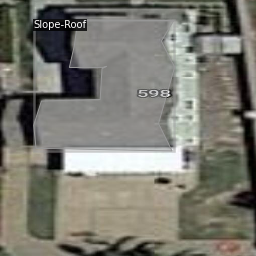

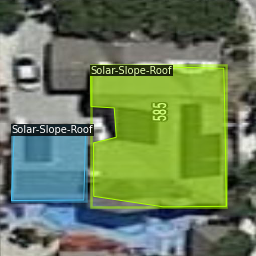

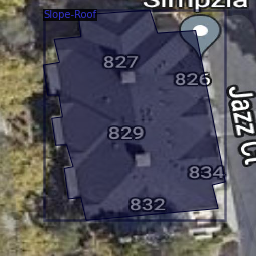

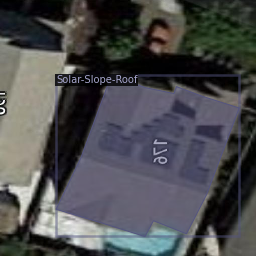

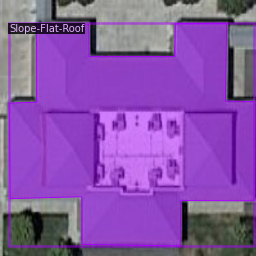

In [ ]:
#visualize training data

my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")



for d in random.sample(dataset_dicts, 5):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Configure Detectron2 for fine tuning from COCO, Define training loop helper functions (from detectron2 repo), Run custom training loop

In [ ]:
cfg = get_cfg()             #mask_rcnn_R_50_FPN_3x.yaml
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)#Train dataset registered in a previous cell
cfg.DATASETS.TEST = ("my_dataset_test",)#Test dataset registered in a previous cell
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025

cfg.SOLVER.MAX_ITER = 2000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = []
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 14 #13 roof types plus one super class (We have removed a non roof class)
cfg.TEST.EVAL_PERIOD = 0 # Increase this number if you want to monitor validation performance during training

PATIENCE = 500 #Early stopping will occur after N iterations of no imporovement in total_loss

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

In [ ]:
def get_evaluator(cfg, dataset_name, output_folder=None):
    """
    Create evaluator(s) for a given dataset.
    This uses the special metadata "evaluator_type" associated with each builtin dataset.
    For your own dataset, you can simply create an evaluator manually in your
    script and do not have to worry about the hacky if-else logic here.
    """
    if output_folder is None:
        output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
    evaluator_list = []
    evaluator_type = MetadataCatalog.get(dataset_name).evaluator_type
    if evaluator_type in ["sem_seg", "coco_panoptic_seg"]:
        evaluator_list.append(
            SemSegEvaluator(
                dataset_name,
                distributed=True,
                output_dir=output_folder,
            )
        )
    if evaluator_type in ["coco", "coco_panoptic_seg"]:
        evaluator_list.append(COCOEvaluator(dataset_name, output_dir=output_folder))
    if evaluator_type == "coco_panoptic_seg":
        evaluator_list.append(COCOPanopticEvaluator(dataset_name, output_folder))
    if evaluator_type == "cityscapes_instance":
        return CityscapesInstanceEvaluator(dataset_name)
    if evaluator_type == "cityscapes_sem_seg":
        return CityscapesSemSegEvaluator(dataset_name)
    if evaluator_type == "pascal_voc":
        return PascalVOCDetectionEvaluator(dataset_name)
    if evaluator_type == "lvis":
        return LVISEvaluator(dataset_name, cfg, True, output_folder)
    if len(evaluator_list) == 0:
        raise NotImplementedError(
            "no Evaluator for the dataset {} with the type {}".format(dataset_name, evaluator_type)
        )
    if len(evaluator_list) == 1:
        return evaluator_list[0]
    return DatasetEvaluators(evaluator_list)

def do_test(cfg, model):
    results = OrderedDict()
    for dataset_name in cfg.DATASETS.TEST:
        data_loader = build_detection_test_loader(cfg, dataset_name)
        evaluator = get_evaluator(
            cfg, dataset_name, os.path.join(cfg.OUTPUT_DIR, "inference", dataset_name)
        )
        results_i = inference_on_dataset(model, data_loader, evaluator)
        results[dataset_name] = results_i
        if comm.is_main_process():
            logger.info("Evaluation results for {} in csv format:".format(dataset_name))
            print_csv_format(results_i)
    if len(results) == 1:
        results = list(results.values())[0]
    return results


logger = logging.getLogger("detectron2")
resume=False
model = build_model(cfg)
optimizer = build_optimizer(cfg, model)
scheduler = build_lr_scheduler(cfg, optimizer)

BEST_LOSS = np.inf

checkpointer = DetectionCheckpointer(
    model, cfg.OUTPUT_DIR, optimizer=optimizer, scheduler=scheduler
)
start_iter = (
    checkpointer.resume_or_load(cfg.MODEL.WEIGHTS, resume=resume).get("iteration", -1) + 1
)
prev_iter = start_iter
max_iter = cfg.SOLVER.MAX_ITER

periodic_checkpointer = PeriodicCheckpointer(
    checkpointer, cfg.SOLVER.CHECKPOINT_PERIOD, max_iter=max_iter
)

writers = default_writers(cfg.OUTPUT_DIR, max_iter) if comm.is_main_process() else []

# compared to "train_net.py", we do not support accurate timing and
# precise BN here, because they are not trivial to implement in a small training loop
data_loader = build_detection_train_loader(cfg)
logger.info("Starting training from iteration {}".format(start_iter))
patience_counter = 0
with EventStorage(start_iter) as storage:
    for data, iteration in zip(data_loader, range(start_iter, max_iter)):
        storage.iter = iteration

        loss_dict = model(data)
        losses = sum(loss_dict.values())
        assert torch.isfinite(losses).all(), loss_dict

        loss_dict_reduced = {k: v.item() for k, v in comm.reduce_dict(loss_dict).items()}
        losses_reduced = sum(loss for loss in loss_dict_reduced.values())
        if comm.is_main_process():
            storage.put_scalars(total_loss=losses_reduced, **loss_dict_reduced)

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        storage.put_scalar("lr", optimizer.param_groups[0]["lr"], smoothing_hint=False)
        scheduler.step()

        if (
            cfg.TEST.EVAL_PERIOD > 0
            and (iteration + 1) % cfg.TEST.EVAL_PERIOD == 0
            and iteration != max_iter - 1
        ):
            do_test(cfg, model)
            # Compared to "train_net.py", the test results are not dumped to EventStorage
            comm.synchronize()

        if iteration - start_iter > 5 and (
            (iteration + 1) % 20 == 0 or iteration == max_iter - 1
        ):
            for writer in writers:
                writer.write()
        periodic_checkpointer.step(iteration)
        
        if iteration > prev_iter:
            prev_iter = iteration
            if losses_reduced < BEST_LOSS:
                BEST_LOSS = losses_reduced
                patience_counter = 0
            else:
                patience_counter += 1
                if patience_counter % 100 == 0:
                    print(f"Loss has not improved for {patience_counter} iterations")
                if patience_counter >= PATIENCE:
                    print(f"EARLY STOPPING")
                    break
                
do_test(cfg, model)

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (15, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (15,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (56, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (56,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (14, 256, 1, 

WARNING [08/03 21:16:13 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/03 21:16:13 d2.data.datasets.coco]: Loaded 338 images in COCO format from ./Building-Image-17/train/_annotations.coco.json
[08/03 21:16:13 d2.data.build]: Removed 0 images with no usable annotations. 338 images left.
[08/03 21:16:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[08/03 21:16:13 d2.data.build]: Using training sampler TrainingSampler
[08/03 21:16:13 d2.data.common]: Serializing 338 elements to byte tensors and concatenating them all ...
[08/03 21:16:13 d2.data.common]: Serialized dataset takes 0.19 MiB
[08/03 21:16:13 detectron2]: Starting training from iteration 0
[08/03 21:16:28 d2.utils.events]:  iter: 19  total_loss: 3.479  loss_cls: 2.65  loss_box_reg: 0.09729  loss_mask: 0.6927  

OrderedDict([('bbox',
              {'AP': 20.160027114601174,
               'AP-Building-Roof': nan,
               'AP-Commercial-Flat-Roof': 13.333333333333336,
               'AP-Commercial-Slope-Roof': nan,
               'AP-Construction-Area': 0.0,
               'AP-Flat Roof': 60.17326732673267,
               'AP-Playground': nan,
               'AP-Slope-Flat-Roof': 0.0,
               'AP-Slope-Roof': 53.36295424961125,
               'AP-Solar-Flat-Roof': 10.03960396039604,
               'AP-Solar-Pannel-Ground': nan,
               'AP-Solar-Slope-Roof': 43.60362506838919,
               'AP-TreeShading-Slope-Roof': 0.9274600929480703,
               'AP-Unknownshape-Roof': 0.0,
               'AP50': 28.28487890688265,
               'AP75': 23.55368792777906,
               'APl': 20.160027114601174,
               'APm': nan,
               'APs': nan}),
             ('segm',
              {'AP': 20.93406432188372,
               'AP-Building-Roof': nan,
            

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output


# Test model and show example output

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[08/03 21:51:12 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,8,3,3)         |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

Segmented Area : 92082 pixel-sq


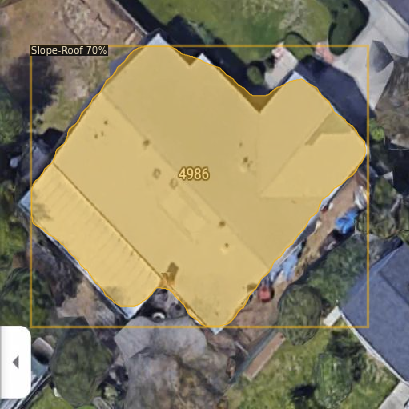

Segmented Area : 60389 pixel-sq


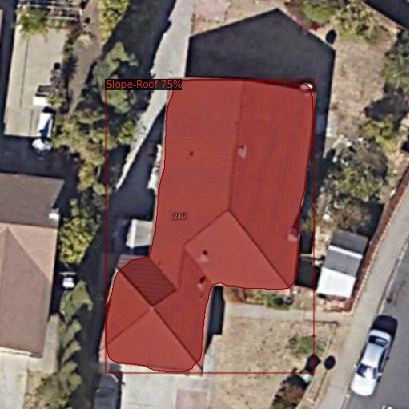

No Segmentation/Classification


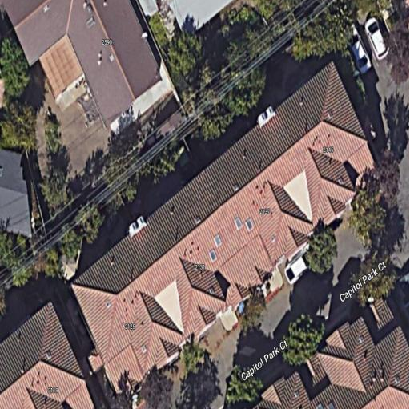

Segmented Area : 65234 pixel-sq


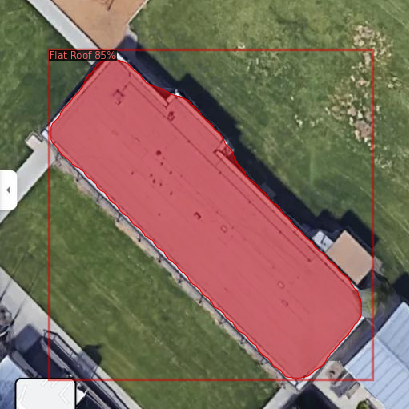

Segmented Area : 57174 pixel-sq


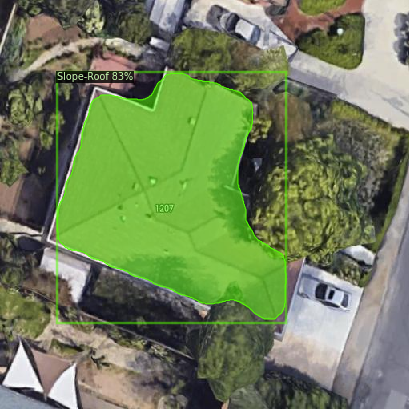

Segmented Area : 88954 pixel-sq


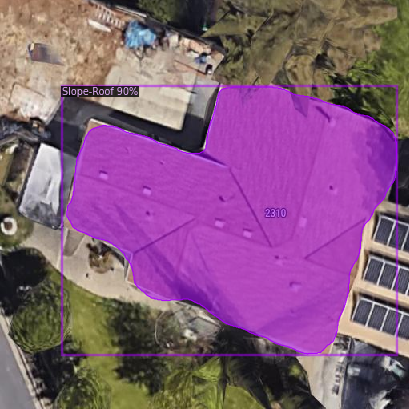

Segmented Area : 44699 pixel-sq


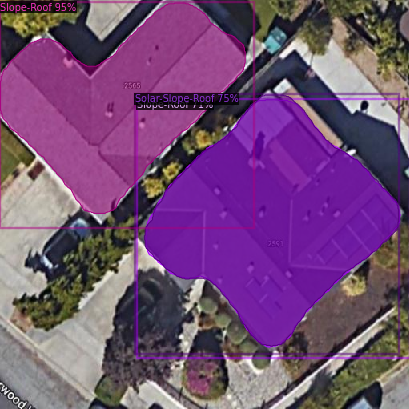

Segmented Area : 107281 pixel-sq


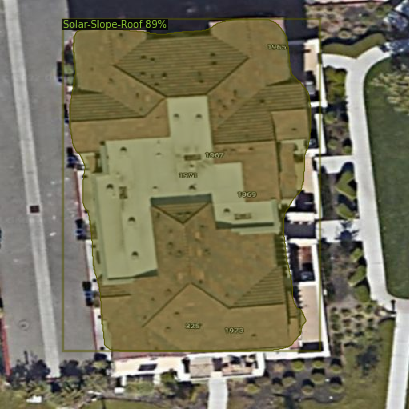

No Segmentation/Classification


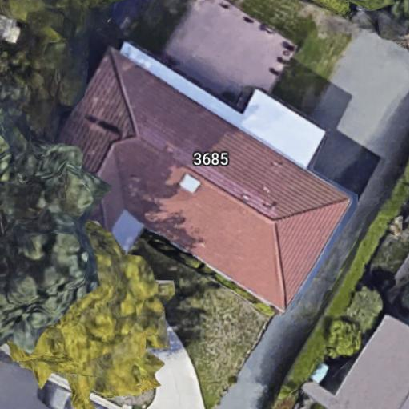

No Segmentation/Classification


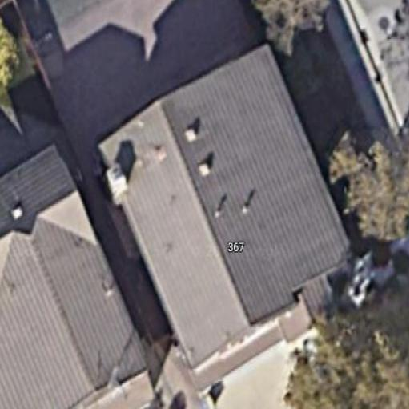

No Segmentation/Classification


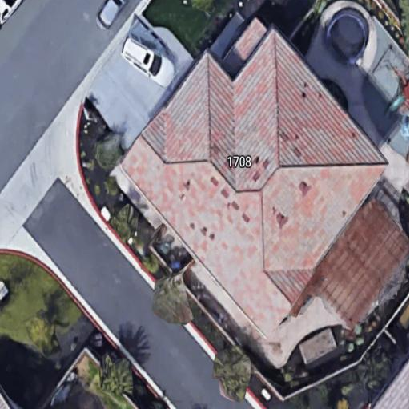

No Segmentation/Classification


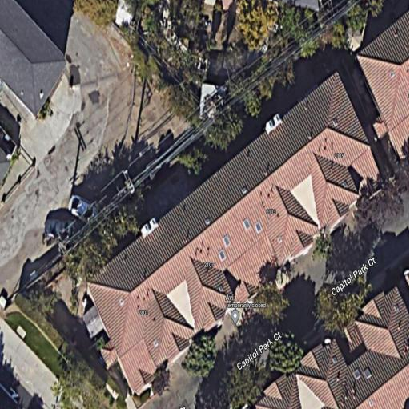

No Segmentation/Classification


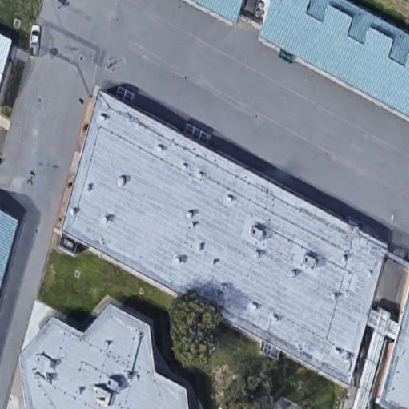

Segmented Area : 90508 pixel-sq


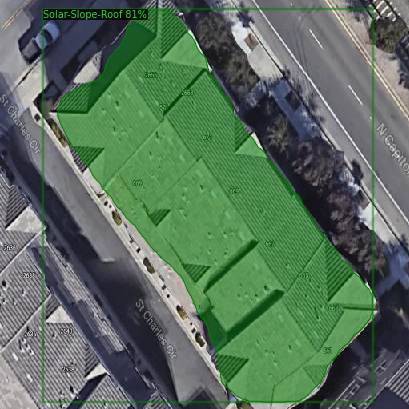

Segmented Area : 73482 pixel-sq


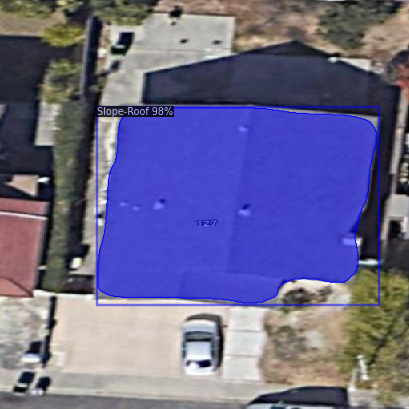

Segmented Area : 146702 pixel-sq


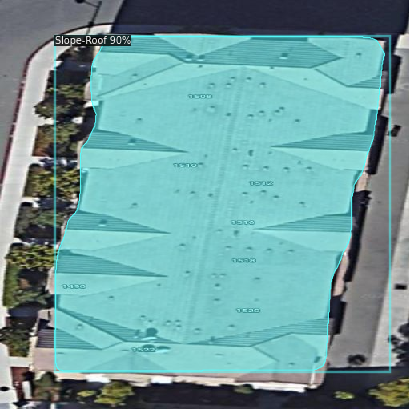

Segmented Area : 96428 pixel-sq


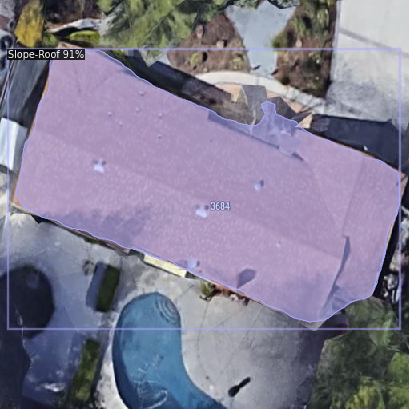

Segmented Area : 149758 pixel-sq


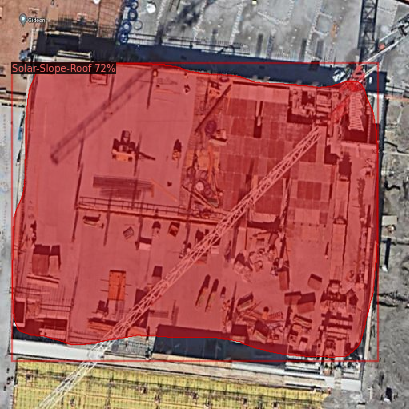

Segmented Area : 53262 pixel-sq


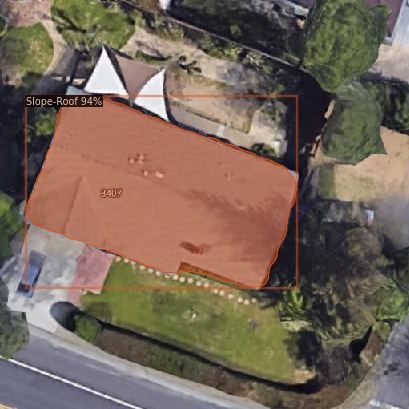

Segmented Area : 66995 pixel-sq


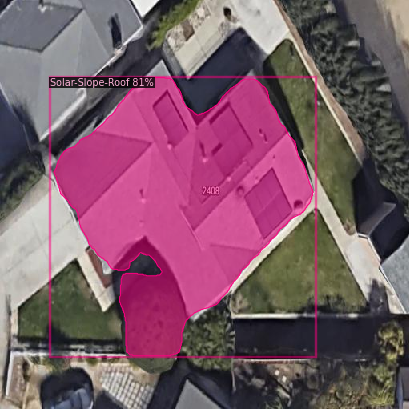

Segmented Area : 84311 pixel-sq


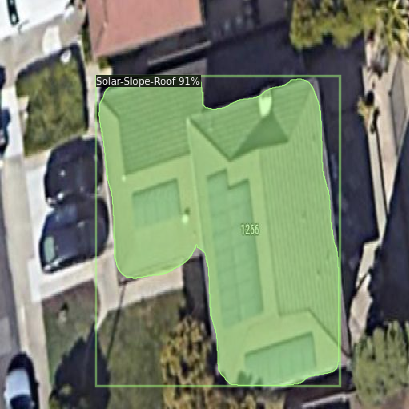

No Segmentation/Classification


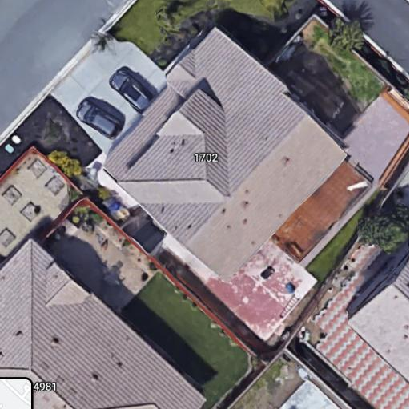

Segmented Area : 68079 pixel-sq


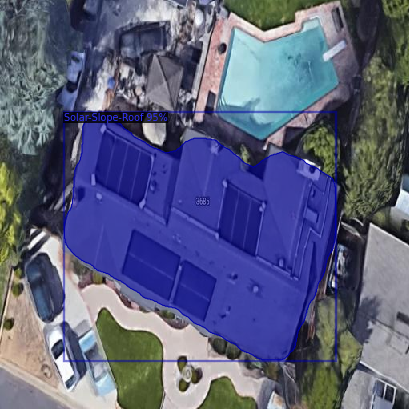

No Segmentation/Classification


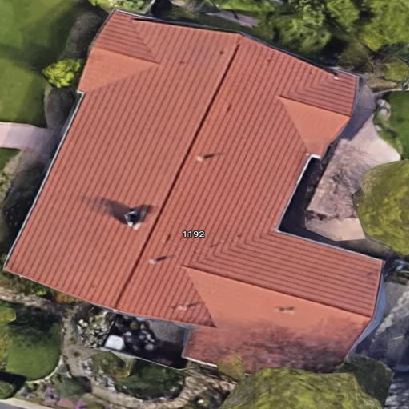

Segmented Area : 104994 pixel-sq


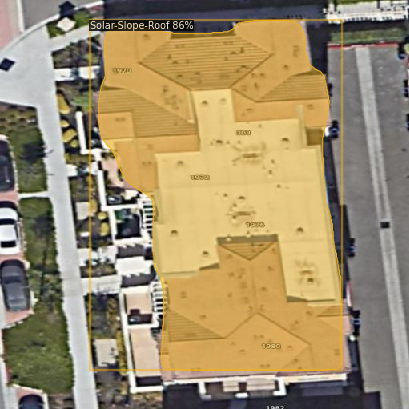

Segmented Area : 71857 pixel-sq


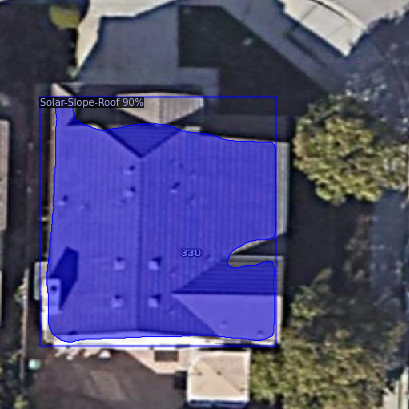

Segmented Area : 59313 pixel-sq


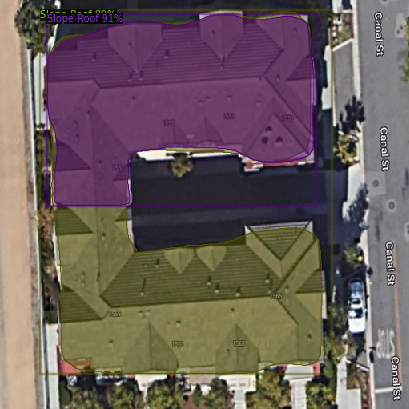

Segmented Area : 73451 pixel-sq


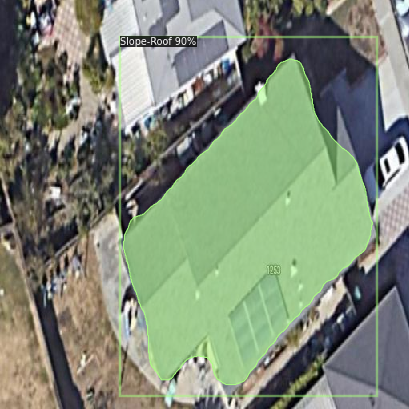

Segmented Area : 65190 pixel-sq


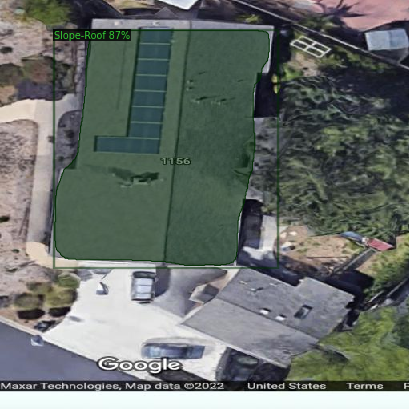

Segmented Area : 97226 pixel-sq


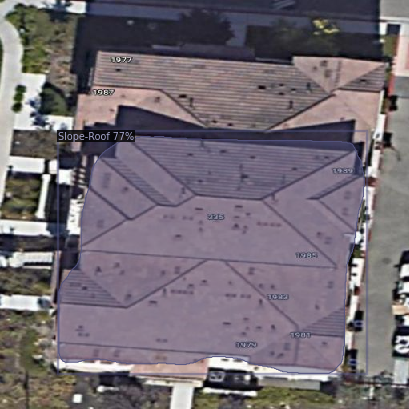

No Segmentation/Classification


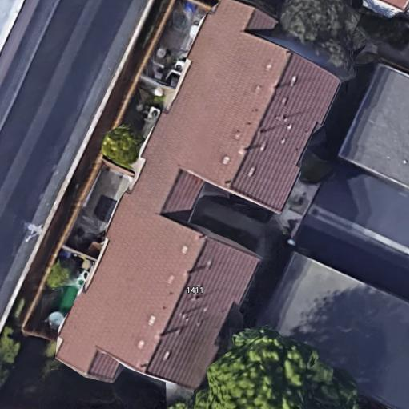

No Segmentation/Classification


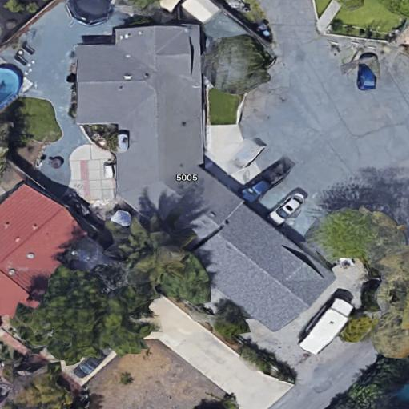

No Segmentation/Classification


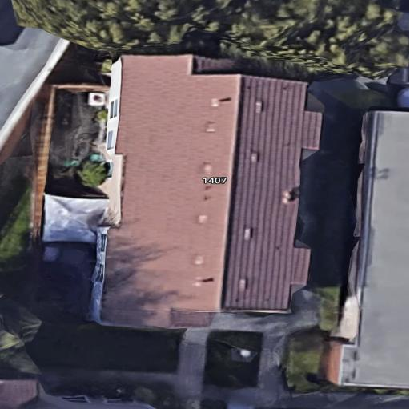

Segmented Area : 68610 pixel-sq


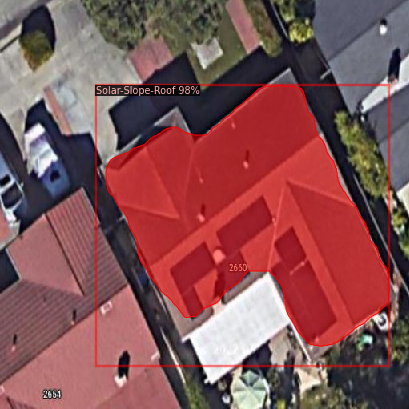

No Segmentation/Classification


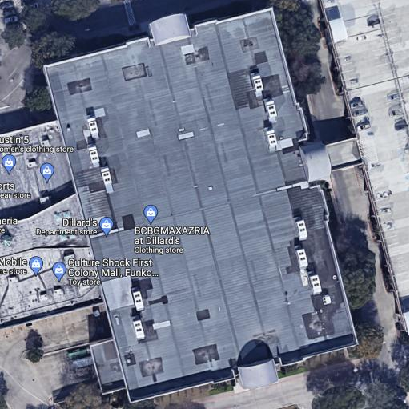

Segmented Area : 80518 pixel-sq


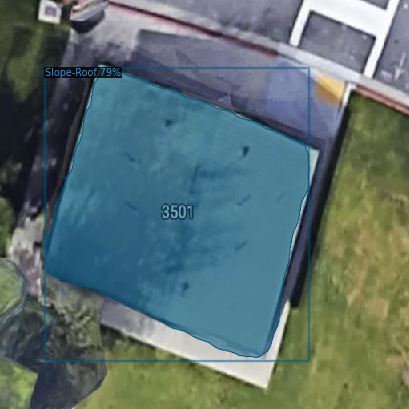

No Segmentation/Classification


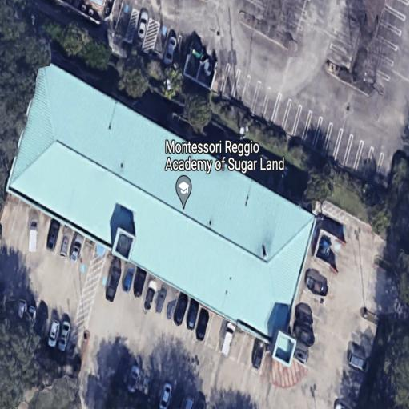

Segmented Area : 77534 pixel-sq


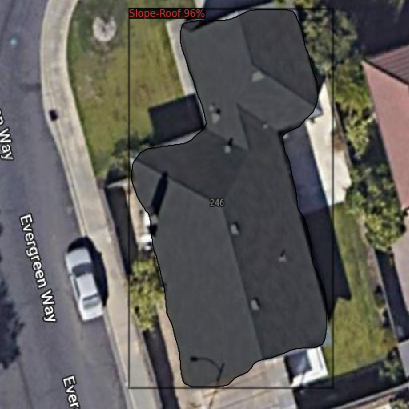

No Segmentation/Classification


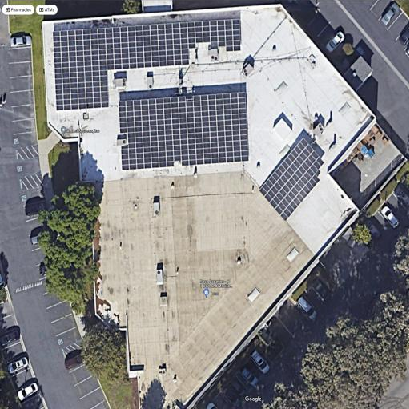

No Segmentation/Classification


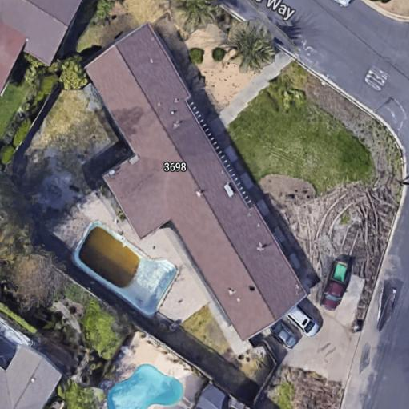

Segmented Area : 71752 pixel-sq


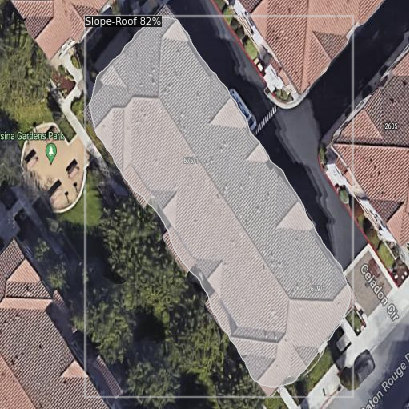

No Segmentation/Classification


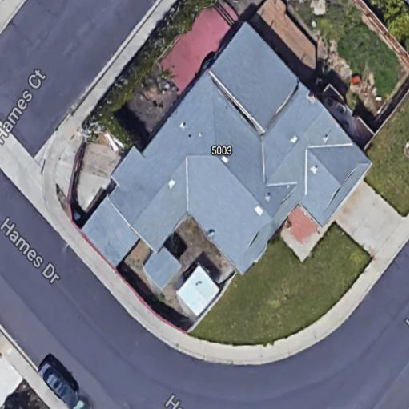

Segmented Area : 70527 pixel-sq


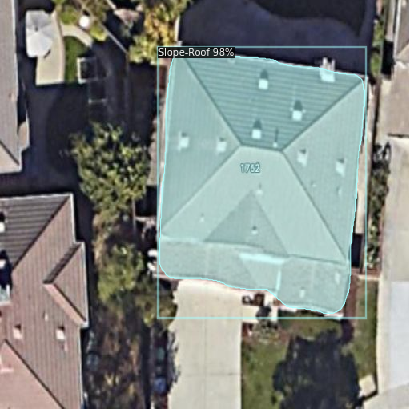

Segmented Area : 116579 pixel-sq


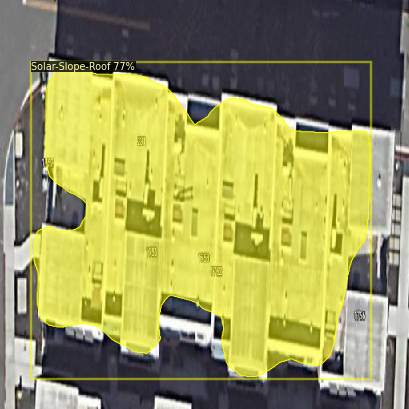

No Segmentation/Classification


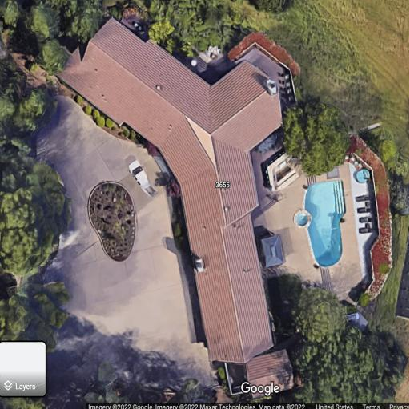

Segmented Area : 52015 pixel-sq


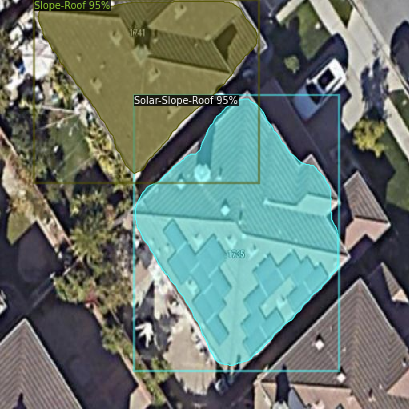

Segmented Area : 69758 pixel-sq


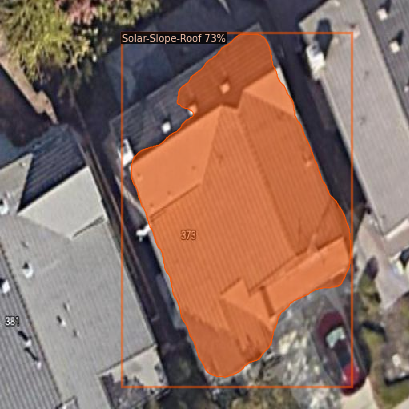

No Segmentation/Classification


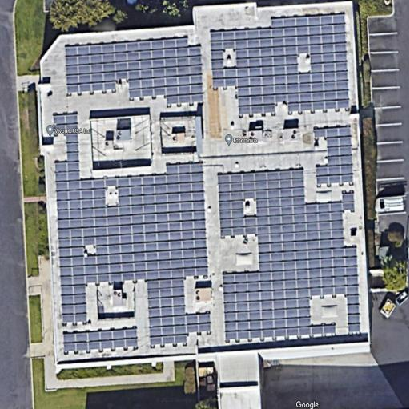

No Segmentation/Classification


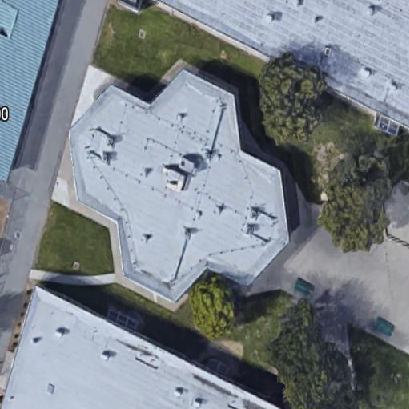

Segmented Area : 71892 pixel-sq


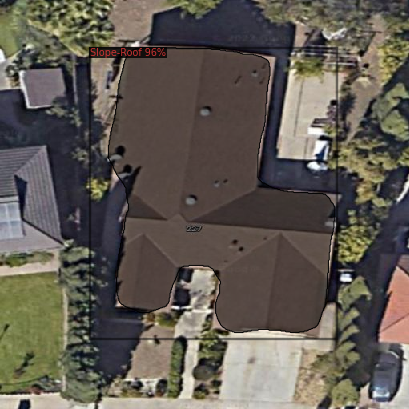

Segmented Area : 76805 pixel-sq


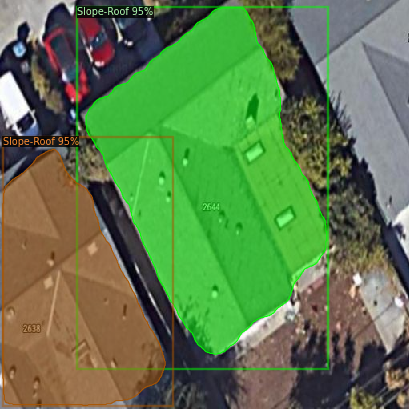

Segmented Area : 109206 pixel-sq


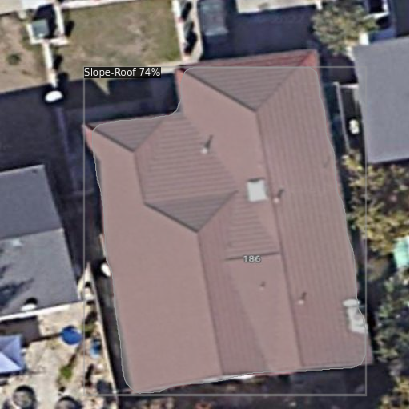

Segmented Area : 136372 pixel-sq


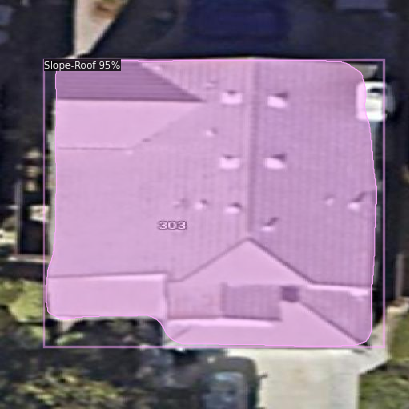

Segmented Area : 75003 pixel-sq


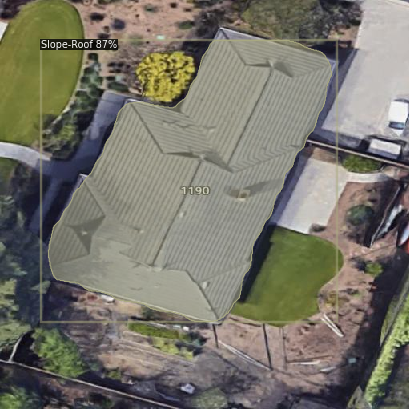

Segmented Area : 110749 pixel-sq


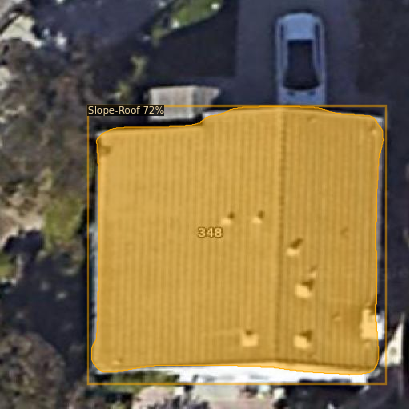

Segmented Area : 59058 pixel-sq


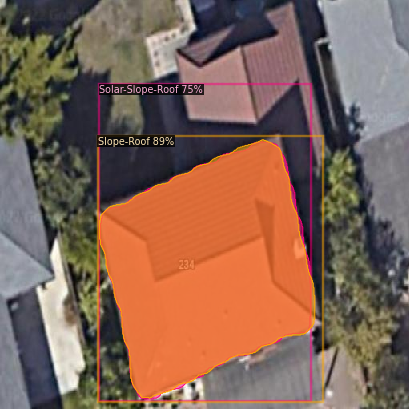

Segmented Area : 53467 pixel-sq


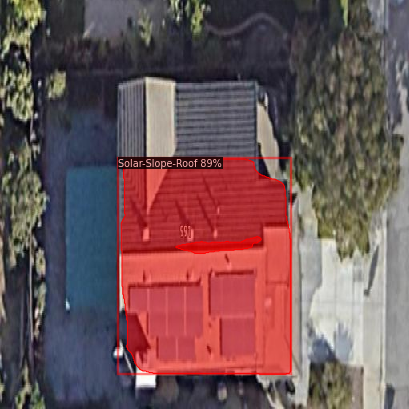

Segmented Area : 59975 pixel-sq


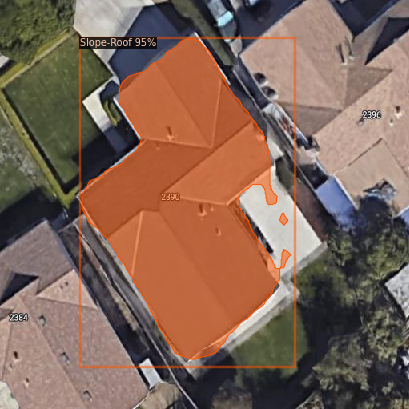

Segmented Area : 74863 pixel-sq


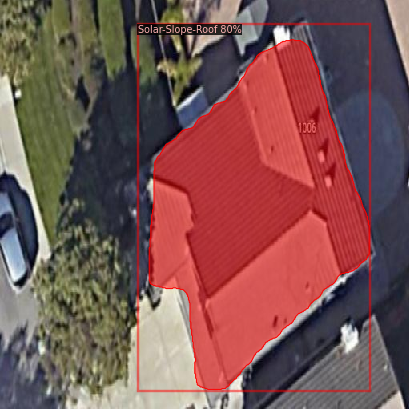

Segmented Area : 81199 pixel-sq


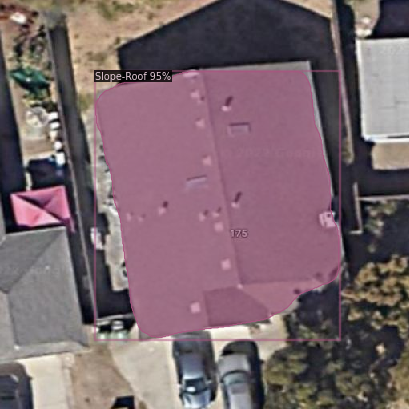

No Segmentation/Classification


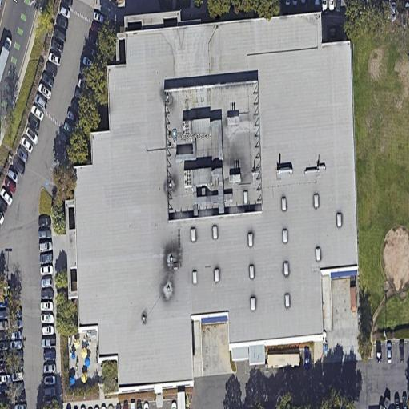

Segmented Area : 113205 pixel-sq


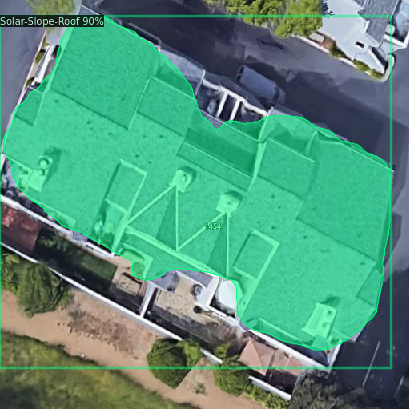

Segmented Area : 94610 pixel-sq


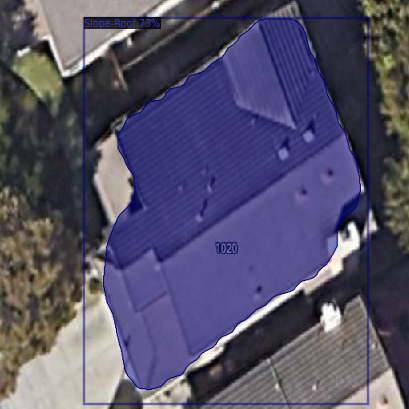

Segmented Area : 131914 pixel-sq


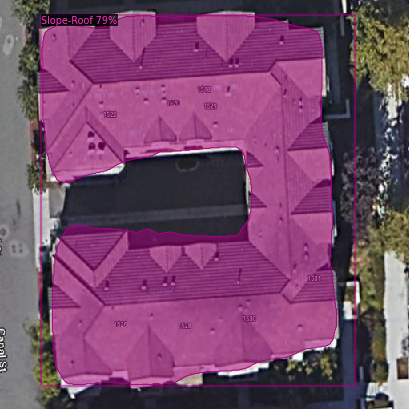

Segmented Area : 78596 pixel-sq


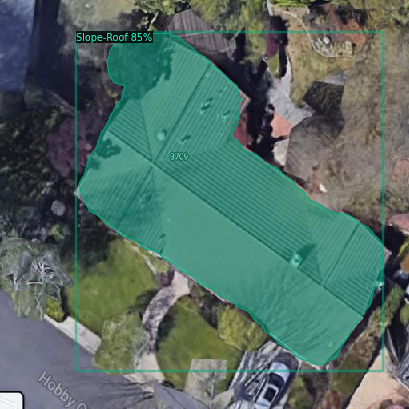

Segmented Area : 36899 pixel-sq


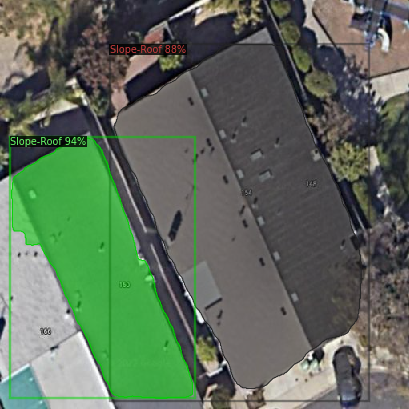

Segmented Area : 97066 pixel-sq


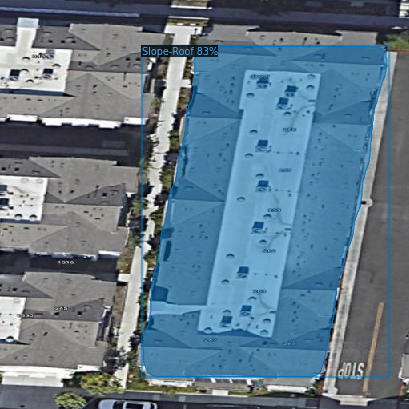

Segmented Area : 32753 pixel-sq


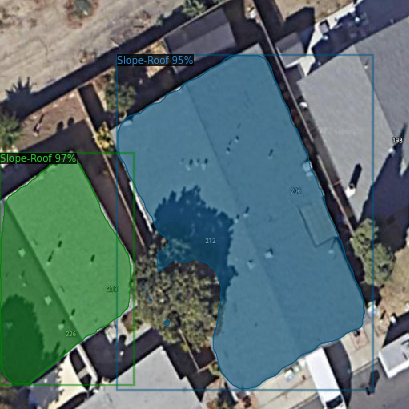

Segmented Area : 112488 pixel-sq


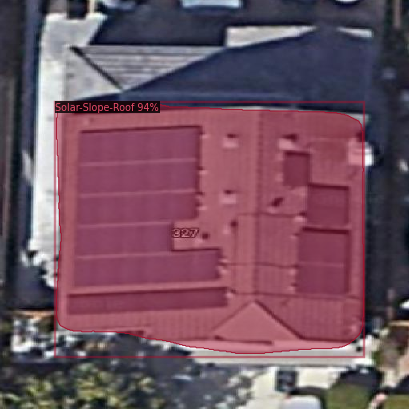

Segmented Area : 34722 pixel-sq


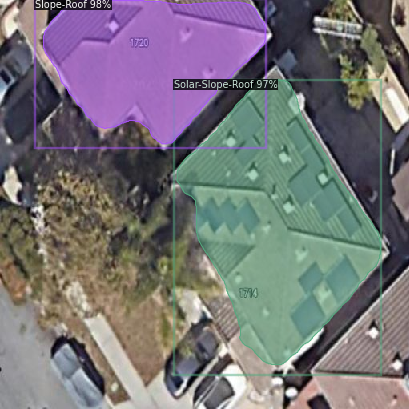

Segmented Area : 97565 pixel-sq


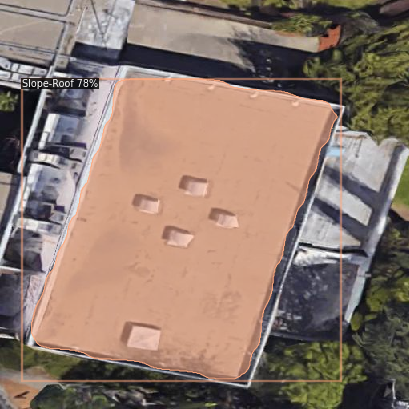

Segmented Area : 54546 pixel-sq


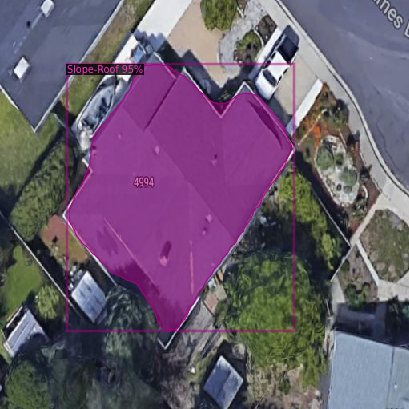

Segmented Area : 66484 pixel-sq


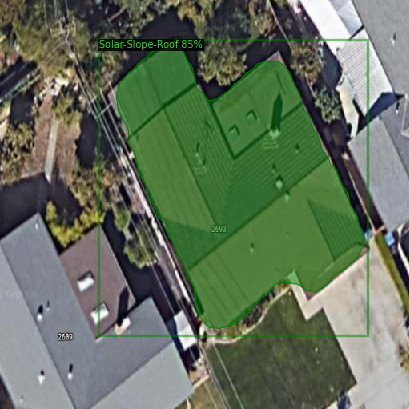

Segmented Area : 90047 pixel-sq


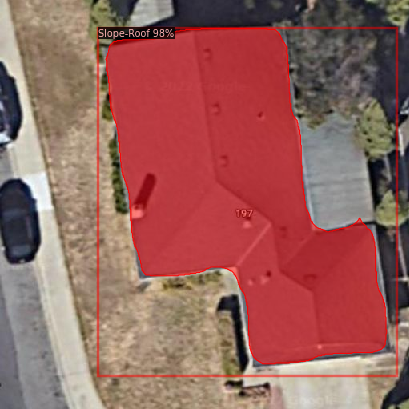

Segmented Area : 56766 pixel-sq


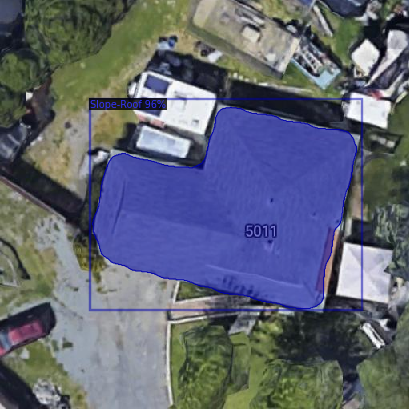

No Segmentation/Classification


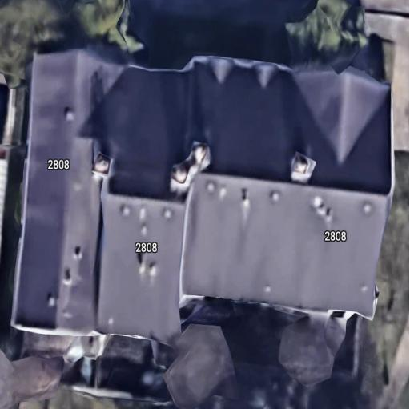

Segmented Area : 82336 pixel-sq


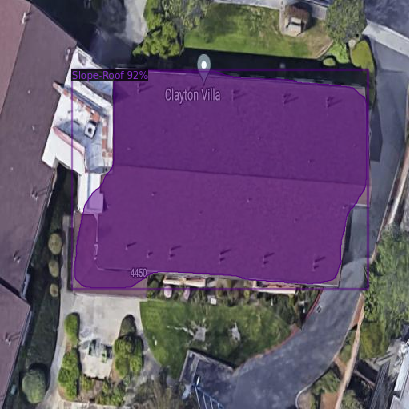

No Segmentation/Classification


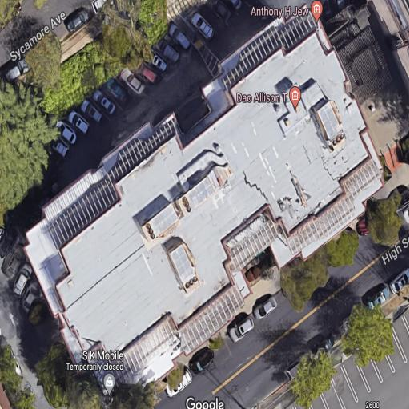

Segmented Area : 70602 pixel-sq


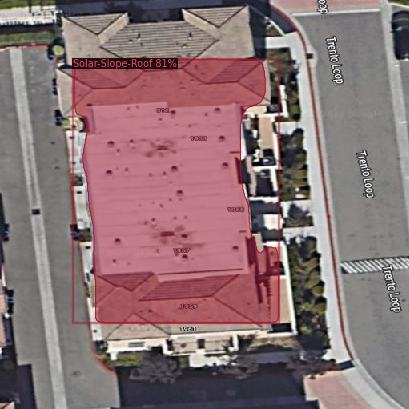

Segmented Area : 65707 pixel-sq


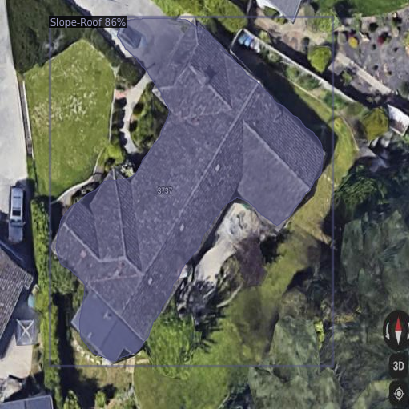

Segmented Area : 69312 pixel-sq


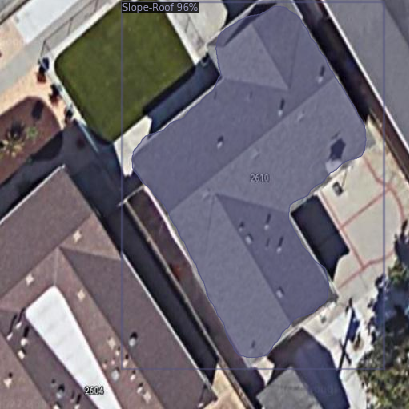

Segmented Area : 45287 pixel-sq


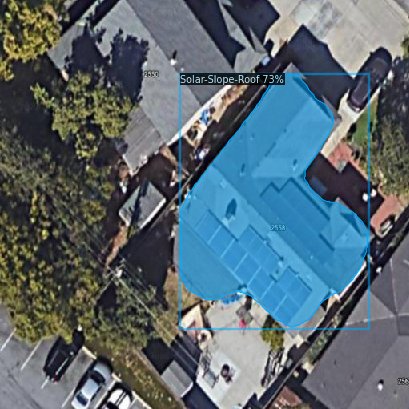

Segmented Area : 125744 pixel-sq


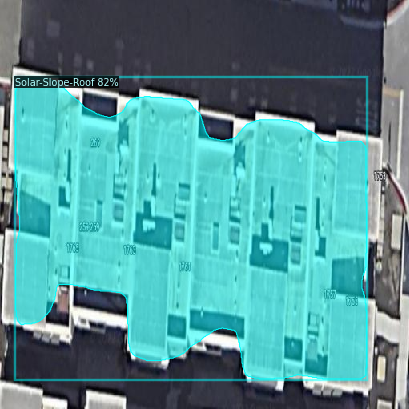

Segmented Area : 120960 pixel-sq


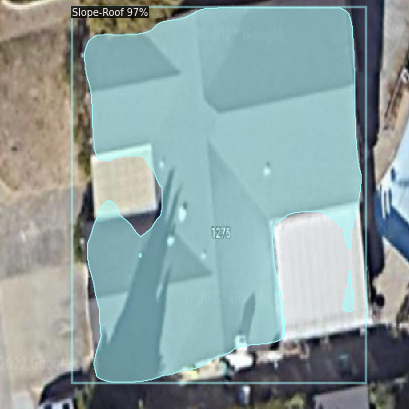

Segmented Area : 80728 pixel-sq


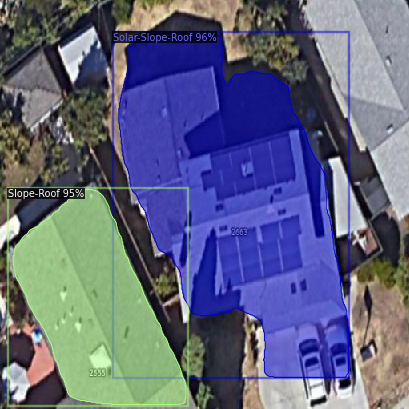

Segmented Area : 51816 pixel-sq


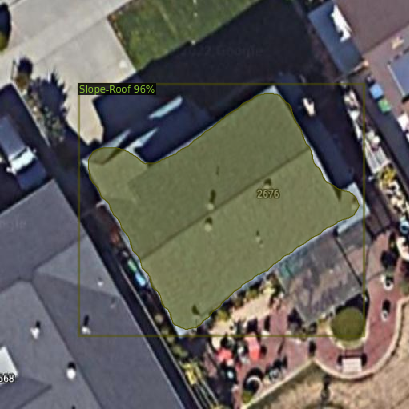

Segmented Area : 113336 pixel-sq


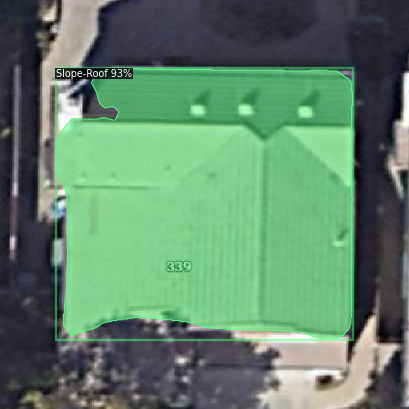

No Segmentation/Classification


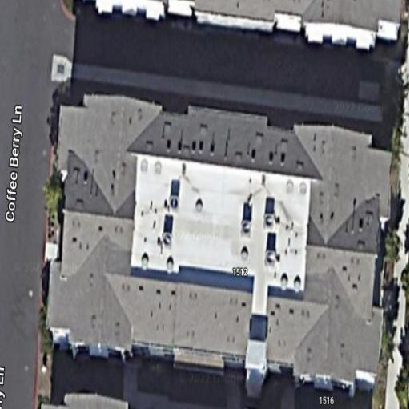

Segmented Area : 97129 pixel-sq


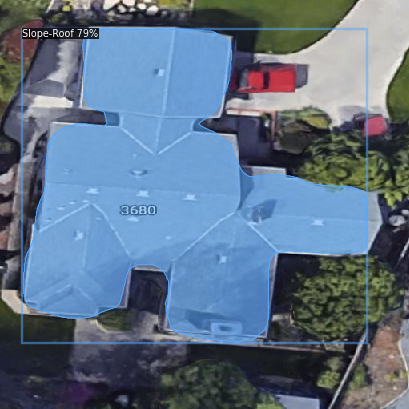

Segmented Area : 107669 pixel-sq


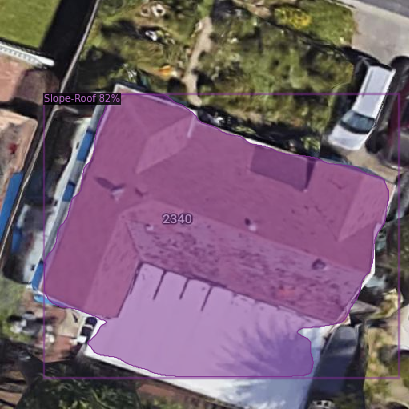

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob(f'/content/Building-Image-{VERSION}/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  pixel_area = outputs["instances"].to("cpu").pred_masks.size()[0]
  if pixel_area == 0 :
    print('No Segmentation/Classification')
  else:
    print(f'Segmented Area : {outputs["instances"].to("cpu").pred_masks[0].numpy().sum()} pixel-sq')
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
 

# Download trained model for future inference

In [ ]:
from google.colab import files
files.download(os.path.join(cfg.OUTPUT_DIR, "model_final.pth"))

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# References:-


*   https://roboflow.com
*   https://github.com/facebookresearch/detectron2/blob/main/MODEL_ZOO.md



